# Credit Card User Segmentation

by Ben Lacar

## Data Challenge

You work as a data scientist at a credit card company. A senior VP is leading an effort to **reduce costs associated with signup incentives by offering credit cards with carefully targeted benefits that will attract new cardholders.** As a first step, she would like you to examine cardholder data collected over the last 6 months in order to **understand the various kinds of users who use the company’s products. She is especially interested in getting an idea of which benefits to associate with each new card offering.**

## Features and header names

- CUSTID : Identification of Credit Card holder (Categorical)
- BALANCE : Balance amount left in their account to make purchases (
- BALANCEFREQUENCY : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
- PURCHASES : Amount of purchases made from account
- ONEOFFPURCHASES : Maximum purchase amount done in one-go
- INSTALLMENTSPURCHASES : Amount of purchase done in installment
- CASHADVANCE : Cash in advance given by the user
- PURCHASESFREQUENCY : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
- ONEOFFPURCHASESFREQUENCY : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)
- PURCHASESINSTALLMENTSFREQUENCY : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
- CASHADVANCEFREQUENCY : How frequently the cash in advance being paid
- CASHADVANCETRX : Number of Transactions made with "Cash in Advanced"
- PURCHASESTRX : Numbe of purchase transactions made
- CREDITLIMIT : Limit of Credit Card for user
- PAYMENTS : Amount of Payment done by user
- MINIMUM_PAYMENTS : Minimum amount of payments made by user
- PRCFULLPAYMENT : Percent of full payment paid by user
- TENURE : Tenure of credit card service for user

## First intuition of the data

From looking at the problem statement and the features, my intuition is that I will need to segment the users with unsupervised methods. I will eventually use PCA to get an overall sense of the distribution of the credit card users and perhaps apply a k-means or heirarchical clustering to determine logical grouping.


## Summary of project

I was tasked to "understand the various kinds of users who use the company’s products" and get an idea of "which benefits to associate with each new card offering".

In the following analysis, I used k-means grouping and statistical analysis to identify 15 groups of credit card users. Each credit card user group can be distinguished by a set of features that separated themselves from the other groups. (See the table at the end of the notebook.) Hence, new users that can be assigned to a group can be targeted with certain incentives.


In [1]:
# Import libraries
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline
import seaborn as sns
import pandas_profiling as pp
import etsy_py
from scipy.stats import shapiro
from scipy.stats import skew
from scipy.stats import kurtosis

In [2]:
# Stats
from scipy.stats import mannwhitneyu
from scipy.stats import ttest_ind
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [3]:
# Code formatting Jupyter black
%load_ext nb_black

<IPython.core.display.Javascript object>

In [4]:
# Termcolor
from termcolor import colored

<IPython.core.display.Javascript object>

# Initial Data Analysis

In [5]:
def initial_analysis(df):
    """
    Given a dataframe produces a simple report on initial data analytics
    Params:
        - df 
    Returns:
        - Shape of dataframe records and columns
        - Columns and data types
    """
    print("Report of Initial Data Analysis:\n")
    print(f"Shape of dataframe: {df.shape}")
    print(f"Features and Data Types: \n {df.dtypes}")

<IPython.core.display.Javascript object>

In [6]:
def percent_missing(df):
    """
    Given a dataframe it calculates the percentage of missing records per column
    Params:
        - df
    Returns:
        - Dictionary of column name and percentage of missing records
    """
    col = list(df.columns)
    perc = [round(df[c].isna().mean() * 100, 2) for c in col]
    miss_dict = dict(zip(col, perc))
    return miss_dict

<IPython.core.display.Javascript object>

In [7]:
def normality_test(df, col_list):
    """
    Given a dataframe determines whether each numerical column is Gaussian 
    Ho = Assumes distribution is not Gaussian
    Ha = Assumes distribution is Gaussian
    Params:
        - df
    Returns:
        - W Statistic
        - p-value
        - List of columns that do not have gaussian distribution
    """
    non_gauss = []
    w_stat = []
    # Determine if each sample of numerical feature is gaussian
    alpha = 0.05
    for n in numeric_list:
        stat, p = shapiro(df[n])
        print(sns.distplot(df[n]))
        print(tuple(skew(df[n]), kurtosis(df[n])))

        if p <= alpha:  # Reject Ho -- Distribution is not normal
            non_gauss.append(n)
            w_stat.append(stat)
    # Dictionary of numerical features not gaussian and W-Statistic
    norm_dict = dict(zip(non_gauss, w_stat))
    return norm_dict

<IPython.core.display.Javascript object>

In [8]:
# Outliers

<IPython.core.display.Javascript object>

In [9]:
os.listdir()

['breast-cancer-wisconsin.txt',
 'dc2_credit_card',
 'BL_data_challenge_notebook.ipynb',
 'Building Data Challenge Notebook.ipynb',
 'Lacar_Ben_dc2_credit_card.ipynb',
 'Lacar_Ben.ipynb',
 'Berlin_Katja_DC_Breast_cancer.ipynb',
 '.ipynb_checkpoints',
 'Breast Cancer Detection.docx']

<IPython.core.display.Javascript object>

In [18]:
# Load data
df_cc = pd.read_csv("dc2_credit_card/cc_info.csv")
df_cc.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


<IPython.core.display.Javascript object>

In [19]:
initial_analysis(df_cc)

Report of Initial Data Analysis:

Shape of dataframe: (8950, 18)
Features and Data Types: 
 CUST_ID                              object
BALANCE                             float64
BALANCE_FREQUENCY                   float64
PURCHASES                           float64
ONEOFF_PURCHASES                    float64
INSTALLMENTS_PURCHASES              float64
CASH_ADVANCE                        float64
PURCHASES_FREQUENCY                 float64
ONEOFF_PURCHASES_FREQUENCY          float64
PURCHASES_INSTALLMENTS_FREQUENCY    float64
CASH_ADVANCE_FREQUENCY              float64
CASH_ADVANCE_TRX                      int64
PURCHASES_TRX                         int64
CREDIT_LIMIT                        float64
PAYMENTS                            float64
MINIMUM_PAYMENTS                    float64
PRC_FULL_PAYMENT                    float64
TENURE                                int64
dtype: object


<IPython.core.display.Javascript object>

In [20]:
percent_missing(df_cc)

{'CUST_ID': 0.0,
 'BALANCE': 0.0,
 'BALANCE_FREQUENCY': 0.0,
 'PURCHASES': 0.0,
 'ONEOFF_PURCHASES': 0.0,
 'INSTALLMENTS_PURCHASES': 0.0,
 'CASH_ADVANCE': 0.0,
 'PURCHASES_FREQUENCY': 0.0,
 'ONEOFF_PURCHASES_FREQUENCY': 0.0,
 'PURCHASES_INSTALLMENTS_FREQUENCY': 0.0,
 'CASH_ADVANCE_FREQUENCY': 0.0,
 'CASH_ADVANCE_TRX': 0.0,
 'PURCHASES_TRX': 0.0,
 'CREDIT_LIMIT': 0.01,
 'PAYMENTS': 0.0,
 'MINIMUM_PAYMENTS': 3.5,
 'PRC_FULL_PAYMENT': 0.0,
 'TENURE': 0.0}

<IPython.core.display.Javascript object>

# Data Wrangling

## Check for duplicates

In [33]:
n_duplicate_rows = df_cc.duplicated().sum()

text = colored("%d rows are duplicates" % n_duplicate_rows, "red", attrs=["reverse"],)
print(text)

0 rows are duplicates


<IPython.core.display.Javascript object>

In [22]:
# Duplicates are not always next to each other
# df_cc.head()

<IPython.core.display.Javascript object>

In [34]:
# Check that the number of unique customer ID matches the number of rows of the dataframe all unique

n_unique_id = len(df_cc["CUST_ID"].unique())
n_rows_of_df = df_cc.shape[0]

text = colored(
    "%d unique IDs, %d dataframe rows" % (n_unique_id, n_rows_of_df), "red", attrs=["reverse"],
)
print(text)


8950 unique IDs, 8950 dataframe rows


<IPython.core.display.Javascript object>

## Set the customer ID as the index of the dataframe

In [35]:
df_cc.set_index("CUST_ID", inplace=True)

<IPython.core.display.Javascript object>

## Investigate / deal with missing values

### Are missing values in MINIMUM_PAYMENTS correlated with values of other features?
From above, 3.5% of the 8950 users have no values for minimum payments (313 users). Anything significant about these users?


In [44]:
# Shows that the the vast majority of minimum payments are < 1000
df_cc["MINIMUM_PAYMENTS"].quantile([0, 0.25, 0.5, 0.75, 1])

0.00        0.019163
0.25      169.123707
0.50      312.343947
0.75      825.485459
1.00    76406.207520
Name: MINIMUM_PAYMENTS, dtype: float64

<IPython.core.display.Javascript object>

In [45]:
# Create a feature in the DF of missing minimum payments
df_cc.loc[:, 'missing_min_pay'] = 0
bool_missing_min_pay = df_cc["MINIMUM_PAYMENTS"].isna()
df_cc.loc[bool_missing_min_pay, 'missing_min_pay'] = 1


<IPython.core.display.Javascript object>

In [46]:
def my_boxplot(df, metric_col, bin_col, ax):
    sns.boxplot(x=bin_col, y=metric_col, data=df, ax=ax, palette=["white", "teal"])
    return ax

<IPython.core.display.Javascript object>

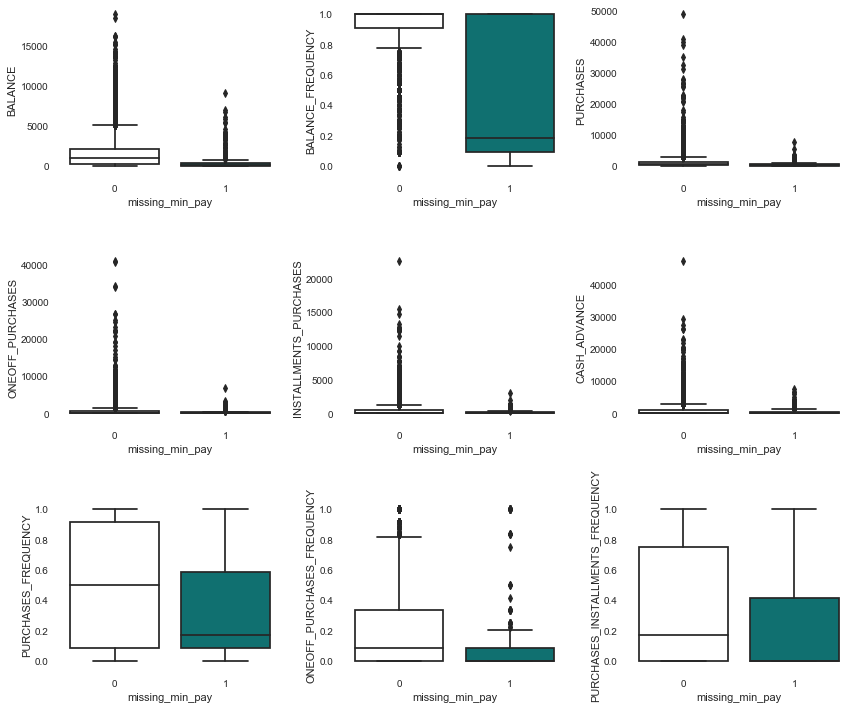

<IPython.core.display.Javascript object>

In [52]:
f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(
    3, 3, figsize=(12, 10)
)

my_boxplot(df_cc, df_cc.columns[0], "missing_min_pay", ax1)
my_boxplot(df_cc, df_cc.columns[1], "missing_min_pay", ax2)
my_boxplot(df_cc, df_cc.columns[2], "missing_min_pay", ax3)
my_boxplot(df_cc, df_cc.columns[3], "missing_min_pay", ax4)
my_boxplot(df_cc, df_cc.columns[4], "missing_min_pay", ax5)
my_boxplot(df_cc, df_cc.columns[5], "missing_min_pay", ax6)
my_boxplot(df_cc, df_cc.columns[6], "missing_min_pay", ax7)
my_boxplot(df_cc, df_cc.columns[7], "missing_min_pay", ax8)
my_boxplot(df_cc, df_cc.columns[8], "missing_min_pay", ax9)
# my_boxplot(df_cc, df_cc.columns[9], "missing_min_pay", ax9)
plt.tight_layout()

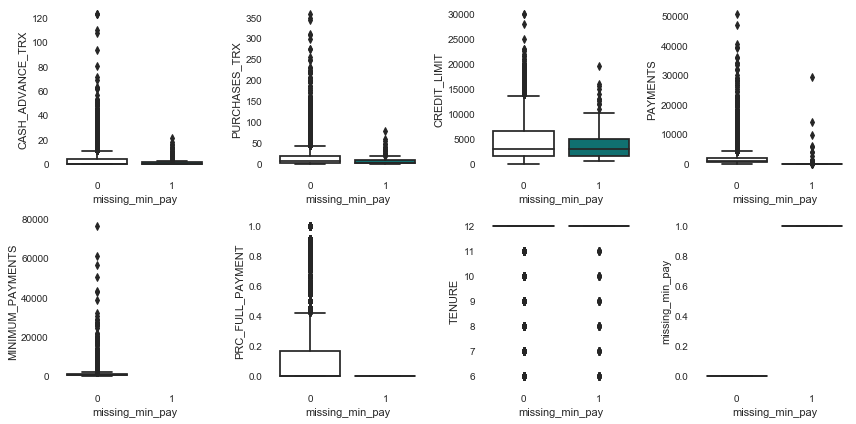

<IPython.core.display.Javascript object>

In [57]:
f, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4, figsize=(12, 6))

my_boxplot(df_cc, df_cc.columns[10], "missing_min_pay", ax1)
my_boxplot(df_cc, df_cc.columns[11], "missing_min_pay", ax2)
my_boxplot(df_cc, df_cc.columns[12], "missing_min_pay", ax3)
my_boxplot(df_cc, df_cc.columns[13], "missing_min_pay", ax4)
my_boxplot(df_cc, df_cc.columns[14], "missing_min_pay", ax5)
my_boxplot(df_cc, df_cc.columns[15], "missing_min_pay", ax6)
my_boxplot(df_cc, df_cc.columns[16], "missing_min_pay", ax7)
my_boxplot(df_cc, df_cc.columns[17], "missing_min_pay", ax8)
plt.tight_layout()

**The main differences that stand out are that those with missing minimum payment data tend to have less frequent balance changes and a lower balance overall. Given that other metrics do not show obvious red flags for those with missing minimum payment values,** <font color='red'> I will assign 0 to the missing data for minimum payment values. </font>

In [107]:
df_cc.fillna(0, inplace=True)

<IPython.core.display.Javascript object>

## Check for negative values

In [108]:
(df_cc < 0).sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
missing_min_pay                     0
dtype: int64

<IPython.core.display.Javascript object>

## Check for non-numeric values

In [109]:
# Inspect unique values and their counts
for col in df_cc.columns[1:]:
    print(col, df_cc[col].value_counts())

BALANCE_FREQUENCY 1.000000    6211
0.909091     410
0.818182     278
0.727273     223
0.545455     219
0.636364     209
0.454545     172
0.363636     170
0.272727     151
0.181818     146
0.000000      80
0.090909      67
0.833333      60
0.875000      57
0.900000      55
0.888889      53
0.857143      51
0.500000      40
0.666667      37
0.333333      22
0.777778      22
0.800000      20
0.571429      19
0.750000      17
0.714286      15
0.700000      13
0.625000      11
0.400000      10
0.555556      10
0.300000       9
0.200000       9
0.375000       9
0.125000       9
0.285714       8
0.100000       8
0.250000       8
0.444444       7
0.166667       7
0.142857       7
0.600000       6
0.111111       5
0.222222       5
0.428571       5
Name: BALANCE_FREQUENCY, dtype: int64
PURCHASES 0.00       2044
45.65        27
150.00       16
60.00        16
100.00       13
           ... 
963.35        1
1260.13       1
203.60        1
35.97         1
169.66        1
Name: PURCHASES, Length: 62

<IPython.core.display.Javascript object>

## Feature Engineering (none)

In [60]:
# TBD

<IPython.core.display.Javascript object>

## Data Formatting

In [110]:
# Verify that data type is changed
initial_analysis(df_cc)

Report of Initial Data Analysis:

Shape of dataframe: (8950, 18)
Features and Data Types: 
 BALANCE                             float64
BALANCE_FREQUENCY                   float64
PURCHASES                           float64
ONEOFF_PURCHASES                    float64
INSTALLMENTS_PURCHASES              float64
CASH_ADVANCE                        float64
PURCHASES_FREQUENCY                 float64
ONEOFF_PURCHASES_FREQUENCY          float64
PURCHASES_INSTALLMENTS_FREQUENCY    float64
CASH_ADVANCE_FREQUENCY              float64
CASH_ADVANCE_TRX                      int64
PURCHASES_TRX                         int64
CREDIT_LIMIT                        float64
PAYMENTS                            float64
MINIMUM_PAYMENTS                    float64
PRC_FULL_PAYMENT                    float64
TENURE                                int64
missing_min_pay                       int64
dtype: object


<IPython.core.display.Javascript object>

<font color='red'>There does not seem to be any negative or non-numeric values to deal with. All values also seem to have proper data types.</font>

# Exploratory Data Analysis

In [111]:
df_cc.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,missing_min_pay
CUST_ID,,,,,,,,,,,,,,,,,,
C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0
C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,0.000000,0.000000,12,1
C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0


<IPython.core.display.Javascript object>

In [112]:
df_cc.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,missing_min_pay
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4493.947277,1733.143852,833.983453,0.153715,11.517318,0.034972
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.922543,2895.063757,2335.989918,0.292499,1.338331,0.183719
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,0.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,163.028164,0.000000,12.000000,0.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,289.628402,0.000000,12.000000,0.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,788.713501,0.142857,12.000000,0.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000,1.000000


<IPython.core.display.Javascript object>

## First-pass using pandas profiling

In [113]:
pp.ProfileReport(df_cc)

<IPython.core.display.Javascript object>

<font color='red'>Using pandas profiling, as a first pass, it seems like many features are heavily right-skewed. I will investigate this further and see if there's just a minority of credit card users that are driving the skewness in the features. </font>

## Unsupervised learning with PCA

In [89]:
from sklearn import decomposition

<IPython.core.display.Javascript object>

In [116]:
def get_scaled_data(X):

    from sklearn import preprocessing

    # Scale features based on training data
    scaler = preprocessing.StandardScaler().fit(X)
    X_scale = scaler.transform(X)

    return X_scale

<IPython.core.display.Javascript object>

In [146]:
def plot_pca(X_scaled_data):
    pca = decomposition.PCA(n_components=2)
    pca.fit(X_scaled_data)

    X_scaled_data_pc = pca.transform(X_scaled_data)

    # Assemble df for plotting
    df4pca = pd.DataFrame(X_scaled_data_pc)
    df4pca.columns = ["PC1", "PC2"]
    df4pca.head()

    # Plot data
    f, ax1 = plt.subplots(figsize=(6, 6))
    ax1.scatter(
        df4pca["PC1"], df4pca["PC2"], facecolors="none", edgecolors="k", linewidth=1
    )
    ax1.set_xlabel("PC1")
    ax1.set_ylabel("PC2")

<IPython.core.display.Javascript object>

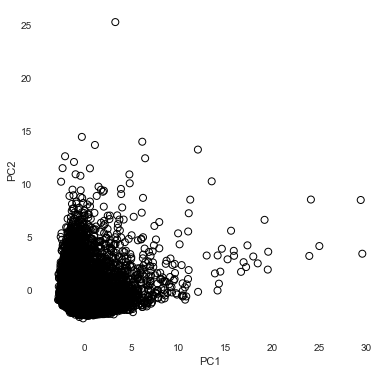

<IPython.core.display.Javascript object>

In [147]:
col2keep = df_cc.columns[0:-1]
X_all_data = df_cc[col2keep].copy()
# Scale data
X_all_data_scale = get_scaled_data(X_all_data)

plot_pca(X_all_data_scale)

<font color='red'>When including all data, a relatively small subset of users is driving the variation, obscuring the variation in the majority of data.</font>

## Check if some users are driving skewness of features

In [114]:
# Use quantile to check values at different quantile bins at 0.5 and above
for col in df_cc.columns:
    print(df_cc[col].quantile(np.arange(0.5, 1.05, 0.1)))

0.5      873.385231
0.6     1207.815587
0.7     1698.588855
0.8     2571.434263
0.9     4338.563657
1.0    19043.138560
Name: BALANCE, dtype: float64
0.5    1.0
0.6    1.0
0.7    1.0
0.8    1.0
0.9    1.0
1.0    1.0
Name: BALANCE_FREQUENCY, dtype: float64
0.5      361.280
0.6      557.546
0.7      894.316
0.8     1422.438
0.9     2542.624
1.0    49039.570
Name: PURCHASES, dtype: float64
0.5       38.000
0.6      168.378
0.7      400.155
0.8      816.992
0.9     1600.099
1.0    40761.250
Name: ONEOFF_PURCHASES, dtype: float64
0.5       89.000
0.6      213.950
0.7      371.139
0.8      603.292
0.9     1140.070
1.0    22500.000
Name: INSTALLMENTS_PURCHASES, dtype: float64
0.5        0.000000
0.6      238.633724
0.7      797.272297
0.8     1574.933778
0.9     3065.534560
1.0    47137.211760
Name: CASH_ADVANCE, dtype: float64
0.5    0.500000
0.6    0.666667
0.7    0.857143
0.8    1.000000
0.9    1.000000
1.0    1.000000
Name: PURCHASES_FREQUENCY, dtype: float64
0.5    0.083333
0.6    0.0833

<IPython.core.display.Javascript object>

In [139]:
df_cc.shape

(8950, 18)

<IPython.core.display.Javascript object>

**Given the right skewness of many features and the PCA visualization, I think it is reasonable to assume that a special set of users in the high end of one feature are likely the same in other features. I will separate out the top 10% of "BALANCE" into a separate group (896 users).**

In [161]:
df_cc_lowend = df_cc.loc[df_cc["BALANCE"] <= df_cc["BALANCE"].quantile(0.90), :].copy()
df_cc_highend = df_cc.loc[df_cc["BALANCE"] > df_cc["BALANCE"].quantile(0.90), :].copy()

<IPython.core.display.Javascript object>

In [165]:
def plot_pca_lowandhigh(X_scaled_data1, X_scaled_data2):

    # Plot data
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    # Low end
    pca = decomposition.PCA(n_components=2)
    pca.fit(X_scaled_data1)
    X_scaled_data1_pc = pca.transform(X_scaled_data1)

    df4pca1 = pd.DataFrame(X_scaled_data1_pc)
    df4pca1.columns = ["PC1", "PC2"]
    df4pca1.head()

    ax1.scatter(
        df4pca1["PC1"], df4pca1["PC2"], facecolors="none", edgecolors="k", linewidth=1
    )
    ax1.set_xlabel("PC1")
    ax1.set_ylabel("PC2")
    ax1.set_title("lower bin")

    # High end
    pca = decomposition.PCA(n_components=2)
    pca.fit(X_scaled_data2)
    X_scaled_data2_pc = pca.transform(X_scaled_data2)

    df4pca2 = pd.DataFrame(X_scaled_data2_pc)
    df4pca2.columns = ["PC1", "PC2"]
    df4pca2.head()

    ax2.scatter(
        df4pca2["PC1"], df4pca2["PC2"], facecolors="none", edgecolors="k", linewidth=1
    )
    ax2.set_xlabel("PC1")
    ax2.set_ylabel("PC2")
    ax2.set_title("upper bin")

<IPython.core.display.Javascript object>

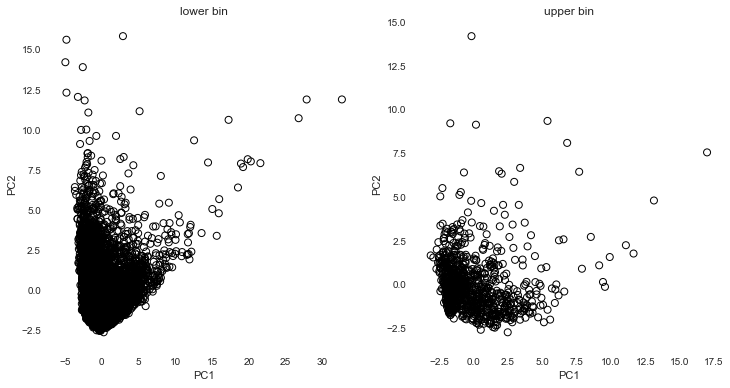

<IPython.core.display.Javascript object>

In [166]:
col2keep = df_cc.columns[0:-1]

X_all_data_lowend = df_cc_lowend[col2keep].copy()
X_all_data_lowend_scale = get_scaled_data(X_all_data_lowend)

X_all_data_highend = df_cc_highend[col2keep].copy()
X_all_data_highend_scale = get_scaled_data(X_all_data_highend)

plot_pca_lowandhigh(X_all_data_lowend_scale, X_all_data_highend_scale)

<font color='red'>The separation is still not clear after group separation. I'll evaluate using k-means grouping. </font>

## Evaluate with k-means

The process of k means is the following:
1. First randomly initialize with a set of k points.
2. Assign the data points to a cluster.
3. Move the centroid to the average of the assigned data points for each group.
4. Repeat the process until the centroids stop moving and converge.

One process for selecting an appropriate k is by plotting the cost function at different values of k and choose the "elbow" point on the graph, which is the value of k that has the biggest improvement in cost and before no further benefit is observed with increasing k.

This post is helpful: https://www.geeksforgeeks.org/elbow-method-for-optimal-value-of-k-in-kmeans/

For cost function, I will focus look at both distortion and intertia.
- Distortion: "It is calculated as the average of the squared distances from the cluster centers of the respective clusters. Typically, the Euclidean distance metric is used."
- Inertia:"It is the sum of squared distances of samples to their closest cluster center."

In [168]:
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt

<IPython.core.display.Javascript object>

My input dataframe will be the scaled dataframe that I created above that contained all data, X_all_data_scale

In [179]:
distortions = []
intertias = []
k_distortion_dict = {}
k_inertia_dict = {}
K = range(1, 30)
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(X_all_data_scale)
    kmeanModel.fit(X_all_data_scale)

    distortion_val = (
        sum(
            np.min(
                cdist(X_all_data_scale, kmeanModel.cluster_centers_, "euclidean"),
                axis=1,
            )
        )
        / X_all_data_scale.shape[0]
    )
    distortions.append(distortion_val)
    k_distortion_dict[k] = distortion_val

    intertia_val = kmeanModel.inertia_
    intertias.append(intertia_val)
    k_inertia_dict[k] = intertia_val

<IPython.core.display.Javascript object>

Text(0.5, 1.0, 'The Elbow Method using Inertia')

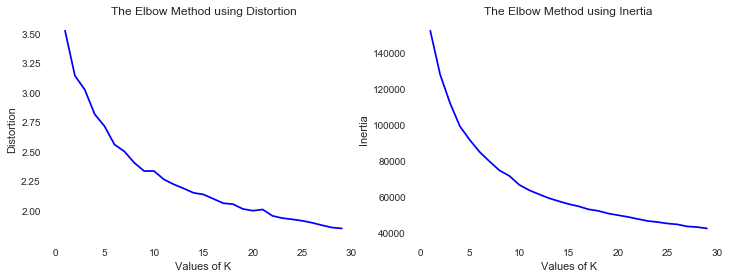

<IPython.core.display.Javascript object>

In [180]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

ax1.plot(K, distortions, "bx-")
ax1.set_xlabel("Values of K")
ax1.set_ylabel("Distortion")
ax1.set_title("The Elbow Method using Distortion")

ax2.plot(K, intertias, "bx-")
ax2.set_xlabel("Values of K")
ax2.set_ylabel("Inertia")
ax2.set_title("The Elbow Method using Inertia")

<font color='red'>While there is not an obvious asymptote, I think it is reasonable to choose a k value of 15 as the number of groups in this dataset. </font>

In [181]:
kmeanModel = KMeans(n_clusters=15).fit(X_all_data_scale)
kmeanModel.fit(X_all_data_scale)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=15, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

<IPython.core.display.Javascript object>

# Explore differences in group assignment

In [182]:
kmeanModel.labels_

array([12, 11,  5, ...,  9,  9,  9], dtype=int32)

<IPython.core.display.Javascript object>

In [187]:
df_cc.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,missing_min_pay,k_means_label
CUST_ID,,,,,,,,,,,,,,,,,,,
C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0,12
C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0,11
C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0,5
C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,0.000000,0.000000,12,1,12
C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0,12


<IPython.core.display.Javascript object>

In [204]:
df_cc.shape

(8950, 19)

<IPython.core.display.Javascript object>

In [186]:
# Assign the label to both the raw and scaled data
df_cc["k_means_label"] = kmeanModel.labels_
df_cc_scaled = pd.DataFrame(X_all_data_scale)
df_cc_scaled.columns = [i + "_scaled" for i in df_cc.columns[:-2]]
df_cc_scaled["k_means_label"] = kmeanModel.labels_

<IPython.core.display.Javascript object>

In [202]:
df_cc_scaled.shape

(8950, 18)

<IPython.core.display.Javascript object>

In [203]:
df_cc_scaled.head()

,BALANCE_scaled,BALANCE_FREQUENCY_scaled,PURCHASES_scaled,ONEOFF_PURCHASES_scaled,INSTALLMENTS_PURCHASES_scaled,CASH_ADVANCE_scaled,PURCHASES_FREQUENCY_scaled,ONEOFF_PURCHASES_FREQUENCY_scaled,PURCHASES_INSTALLMENTS_FREQUENCY_scaled,CASH_ADVANCE_FREQUENCY_scaled,CASH_ADVANCE_TRX_scaled,PURCHASES_TRX_scaled,CREDIT_LIMIT_scaled,PAYMENTS_scaled,MINIMUM_PAYMENTS_scaled,PRC_FULL_PAYMENT_scaled,TENURE_scaled,k_means_label
0,-0.731989,-0.249434,-0.424900,-0.356934,-0.349079,-0.466786,-0.806490,-0.678661,-0.707313,-0.675349,-0.476070,-0.511333,-0.960213,-0.528979,-0.297310,-0.525551,0.36068,12
1,0.786961,0.134325,-0.469552,-0.356934,-0.454576,2.605605,-1.221758,-0.678661,-0.916995,0.573963,0.110074,-0.591796,0.688718,0.818642,0.102042,0.234227,0.36068,11
2,0.447135,0.518084,-0.107668,0.108889,-0.454576,-0.466786,1.269843,2.673451,-0.916995,-0.675349,-0.476070,-0.109020,0.826129,-0.383805,-0.088489,-0.525551,0.36068,5
3,0.049099,-1.016953,0.232058,0.546189,-0.454576,-0.368653,-1.014125,-0.399319,-0.916995,-0.258913,-0.329534,-0.551565,0.826129,-0.598688,-0.357035,-0.525551,0.36068,12
4,-0.358775,0.518084,-0.462063,-0.347294,-0.454576,-0.466786,-1.014125,-0.399319,-0.916995,-0.675349,-0.476070,-0.551565,-0.905249,-0.364368,-0.252238,-0.525551,0.36068,12


<IPython.core.display.Javascript object>

## Boxplot of features by k-means label

### Boxplots of raw data

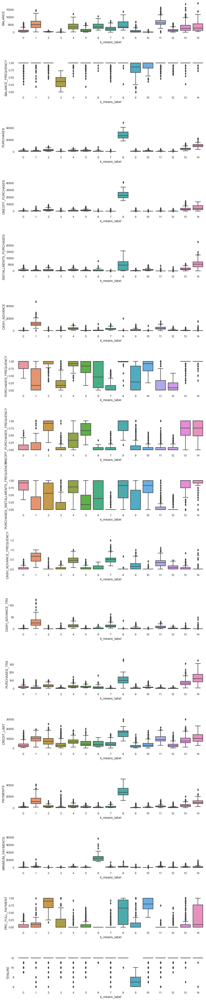

<IPython.core.display.Javascript object>

In [205]:
numSubplotsInt = len(df_cc.columns[:-2])
f, ax = plt.subplots(numSubplotsInt, 1, figsize=(10, 48), sharex=False)

for i in range(numSubplotsInt):
    col2plot = df_cc.columns[i]
    sns.boxplot(data=df_cc, x="k_means_label", y=col2plot, ax=ax[i])

f.tight_layout()

### Boxplots of scaled data 

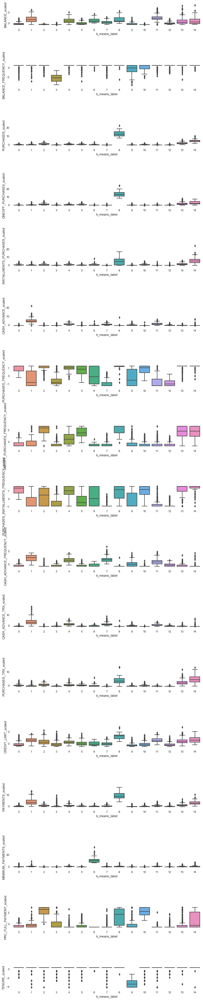

<IPython.core.display.Javascript object>

In [206]:
numSubplotsInt = len(df_cc_scaled.columns[:-1])
f, ax = plt.subplots(numSubplotsInt, 1, figsize=(10, 48), sharex=False)

for i in range(numSubplotsInt):
    col2plot = df_cc_scaled.columns[i]
    sns.boxplot(data=df_cc_scaled, x="k_means_label", y=col2plot, ax=ax[i])

f.tight_layout()

## Statistical analysis to identify most distinguishing features for each group

From looking at the boxplots, it is already clear that some groups can be distinguished by a feature. For example, the users in group 9 are identified by having a lower credit card tenure than the other groups.

But for other features, it is hard to tell what features are identifying those groups. We can use hypothesis testing to identify the top features that distinguish a certain group from another. The strategy would to take one group (e.g. group 0) and compare against all other groups (e.g. groups 1-14) and see what features are significantly different. I'll use Mann-Whitney U test for this.

In [207]:
df_cc.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,missing_min_pay,k_means_label
CUST_ID,,,,,,,,,,,,,,,,,,,
C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0,12
C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0,11
C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0,5
C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,0.000000,0.000000,12,1,12
C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0,12


<IPython.core.display.Javascript object>

In [213]:
def run_mannwhitneyu(df, metric_col, group):
    bool_class_group = df["k_means_label"] == group
    bool_class_notgroup = df["k_means_label"] != group

    x = df.loc[bool_class_group, metric_col].copy()
    y = df.loc[bool_class_notgroup, metric_col].copy()
    mwu_statistic, mwu_pval = mannwhitneyu(x, y, use_continuity=True, alternative=None)
    return mwu_pval

<IPython.core.display.Javascript object>

In [222]:
df_pval_df = pd.DataFrame()
for group in range(14):
    for col in df_cc.columns[:-2]:
        p_val = run_mannwhitneyu(df_cc, col, group)
        df_pval_df.loc[group, col] = p_val


<IPython.core.display.Javascript object>

In [223]:
df_pval_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,2.272572e-09,2.708171e-47,3.136793e-77,1.037113e-21,0.000000e+00,3.022536e-94,0.000000e+00,1.342485e-24,0.000000e+00,1.330873e-95,3.951120e-92,1.065106e-215,6.472099e-45,6.584301e-09,1.699337e-02,8.148622e-11,2.930730e-27
1,1.725440e-43,2.732733e-03,1.264860e-02,3.614172e-01,1.187648e-02,7.211960e-83,1.648605e-05,2.199904e-01,5.953856e-04,8.819741e-67,4.399925e-71,2.254895e-04,5.390310e-40,9.767353e-66,1.698728e-36,7.049565e-04,3.401608e-01
2,3.570298e-41,7.113370e-05,9.928119e-123,1.430153e-151,1.009289e-21,2.273290e-46,8.915119e-89,2.143059e-191,1.117736e-11,1.101066e-46,1.080694e-46,1.722275e-114,1.415723e-43,1.033093e-61,2.257455e-37,1.700392e-248,8.297979e-07
3,0.000000e+00,0.000000e+00,1.460595e-43,5.712678e-22,9.635833e-38,4.122557e-57,1.613384e-71,1.453078e-33,6.407884e-43,7.191147e-78,2.190839e-72,2.116296e-71,1.109651e-10,4.945291e-79,0.000000e+00,2.545283e-06,4.092898e-06
4,1.599465e-76,1.032414e-13,3.991168e-47,5.069996e-28,2.272965e-49,2.626341e-121,1.388527e-50,5.946767e-29,3.165969e-51,1.531330e-135,2.385655e-142,3.800845e-69,2.459180e-39,1.085794e-47,3.802426e-63,2.267186e-09,3.169588e-02
5,1.692274e-05,8.480117e-29,7.147171e-134,2.700191e-247,3.954087e-03,9.762429e-40,2.947221e-83,0.000000e+00,4.881786e-07,1.205884e-38,2.591626e-39,2.092975e-126,2.417735e-09,5.262612e-15,5.085495e-03,7.018068e-05,1.069772e-10
6,4.998669e-14,1.366291e-03,4.950325e-01,2.281477e-03,1.128266e-01,4.210243e-01,3.766898e-01,1.158891e-03,8.054716e-02,2.196915e-01,4.879770e-01,2.581217e-01,2.267913e-01,3.249133e-02,1.716831e-25,1.341469e-05,9.538190e-02
7,6.958462e-87,1.162056e-15,4.719384e-124,2.824963e-35,1.840613e-111,2.068658e-264,3.060632e-153,4.853881e-33,1.121529e-117,0.000000e+00,0.000000e+00,1.165753e-138,8.376685e-05,7.223704e-23,4.257756e-58,2.141028e-16,1.015617e-02
8,2.758565e-09,6.182541e-02,3.556512e-15,1.144390e-16,4.324821e-08,1.148110e-02,1.786655e-06,1.374322e-12,4.816700e-04,3.988253e-03,6.349498e-03,2.326433e-12,3.709370e-13,6.095135e-15,3.083930e-07,6.574749e-08,9.687298e-02
9,2.871058e-16,5.100318e-59,1.633171e-24,1.064012e-14,9.095591e-21,2.075598e-11,3.918055e-09,6.674989e-12,4.326626e-13,2.452964e-15,1.034482e-07,2.394197e-36,1.396522e-70,3.014149e-100,1.436221e-54,7.971845e-04,0.000000e+00


<IPython.core.display.Javascript object>

In [ ]:
# For each group, what are the three lowest p-values?

df_most_sig_features = pd.DataFrame()
for group in range(14):
    df_most_sig_features[group] = df_pval_df.loc[group, :].nsmallest(3).index.tolist()

df_most_sig_features = df_most_sig_features.T
df_most_sig_features.columns = [
    "1st_distinguishing_feature",
    "2nd_distinguishing_feature",
    "3rd_distinguishing_feature",
]

<font color='red'> This table identifies the most significant features for each group. </font>         

In [246]:
df_most_sig_features

,1st_distinguishing_feature,2nd_distinguishing_feature,3rd_distinguishing_feature
0,INSTALLMENTS_PURCHASES,PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY
1,CASH_ADVANCE,CASH_ADVANCE_TRX,CASH_ADVANCE_FREQUENCY
2,PRC_FULL_PAYMENT,ONEOFF_PURCHASES_FREQUENCY,ONEOFF_PURCHASES
3,BALANCE,BALANCE_FREQUENCY,MINIMUM_PAYMENTS
4,CASH_ADVANCE_TRX,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE
5,ONEOFF_PURCHASES_FREQUENCY,ONEOFF_PURCHASES,PURCHASES
6,MINIMUM_PAYMENTS,BALANCE,PRC_FULL_PAYMENT
7,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,CASH_ADVANCE
8,ONEOFF_PURCHASES,PURCHASES,PAYMENTS
9,TENURE,PAYMENTS,CREDIT_LIMIT


<IPython.core.display.Javascript object>

# Summary

## Actionable insights

This project identified 15 groups of credit card users. Each credit card user group can be distinguished by a set of features that separated themselves from the other groups. Hence, new users that can be assigned to a group can be targeted with certain incentives.

For example, group 1 was significantly different for the following three features:
- CASH_ADVANCE
- CASH_ADVANCE_TRX
- CASH_ADVANCE_FREQUENCY

Clearly, cash advances represent significant activity for this group. This means that new users who have similar cash advance activity can be targeted to join by incentivizing cash advances. The analysis also identifies groups where it would *not* make sense to offer cash advance benefits. Similar logic can be applied to other groups. 

## Next steps

Given additional time, here are places for further investigation.

First, the skewness of the data was likely driven by the few users who made large purchases (group 8). Considering their business value ("whale accounts") they can be treated with special care.

From a data science perspective, selection for the number of groups in the k-means analysis relied on visual inspection. Hence there is some subjectivity with this number. It's possible that other methods, like silhouette analysis, could have come up with a different number.

Choosing the top 3 features for each group also was somewhat subjective (versus the top 1, 2 or 5). It's possible that other statistical analysis or more detailed inspection of the p-values could provide a more or less features for each group.